In [116]:
# !pip install ndlib

In [1]:
import networkx as nx
import ndlib.models.epidemics as ep
import ndlib.models.ModelConfig as mc

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import sys

In [4]:
from collections import Counter
from itertools import chain

В условиях ДЗ не указан датасет, использован найденный на просторах Интернета: https://www.kaggle.com/datasets/vikalpdongre/us-flights-data-2008

Для ускорения обработки - предварительно из датасета убраны признаки, не участвующие в условиях ДЗ: DepTime,CRSDepTime,ArrTime,CRSArrTime,UniqueCarrier,FlightNum,TailNum,ActualElapsedTime,CRSElapsedTime,AirTime,ArrDelay,DepDelay,DayOfWeek,TaxiIn,TaxiOut,Cancelled,CancellationCode,Diverted,CarrierDelay,WeatherDelay,NASDelay,SecurityDelay,LateAircraftDelay.
В качестве месяца для анализа выбран сентябрь - при предварительной обработке выбраны только записи для полетов этого месяца.

In [5]:
df = pd.read_csv('US_airways_09.2008.csv', sep=';')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 540908 entries, 0 to 540907
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   Year        540908 non-null  int64 
 1   Month       540908 non-null  int64 
 2   DayofMonth  540908 non-null  int64 
 3   Origin      540908 non-null  object
 4   Dest        540908 non-null  object
 5   Distance    540908 non-null  int64 
dtypes: int64(4), object(2)
memory usage: 24.8+ MB


In [7]:
df.isnull().sum()

Year          0
Month         0
DayofMonth    0
Origin        0
Dest          0
Distance      0
dtype: int64

Пропусков в данных нет, т.к. у нас имитация процесса, продолжающегося во времени - отсортируем датасет по номеру дня месяца

In [8]:
df = df.sort_values(by=['DayofMonth'])
df = df.reset_index(drop=True)

Добавим признак зараженности аэропорта: 0 - не заражен, 1 - заражен

In [9]:
df['Infected'] = 0

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 540908 entries, 0 to 540907
Data columns (total 7 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   Year        540908 non-null  int64 
 1   Month       540908 non-null  int64 
 2   DayofMonth  540908 non-null  int64 
 3   Origin      540908 non-null  object
 4   Dest        540908 non-null  object
 5   Distance    540908 non-null  int64 
 6   Infected    540908 non-null  int64 
dtypes: int64(5), object(2)
memory usage: 28.9+ MB


In [11]:
df.head()

,Year,Month,DayofMonth,Origin,Dest,Distance,Infected
0,2008,9,1,ATL,LIT,453,0
1,2008,9,1,DEN,FAR,627,0
2,2008,9,1,FAR,DEN,627,0
3,2008,9,1,DAY,ORD,240,0
4,2008,9,1,ORD,DAY,240,0


In [12]:
airport_list = df['Origin'].unique()
airport_count = len(airport_list)
all_airways_count = df.shape[0]
print(f'Количество аэропортов: {airport_count}')
print(f'Количество рейсов: {all_airways_count}')

Количество аэропортов: 289
Количество рейсов: 540908


In [13]:
unique, counts = np.unique(df['Origin'], return_counts=True)
airport_dict = dict(zip(unique, counts))
print(f'Количество рейсов каждого аэропорта:')
for key, value in airport_dict.items():
    print(f'{key}: {value}')

Количество рейсов каждого аэропорта:
ABE: 354
ABI: 231
ABQ: 3194
ABY: 86
ACK: 11
ACT: 144
ACV: 313
ADK: 8
ADQ: 60
AEX: 188
AGS: 218
AKN: 13
ALB: 1056
ALO: 26
AMA: 643
ANC: 1582
ASE: 287
ATL: 33095
ATW: 468
AUS: 3733
AVL: 390
AVP: 157
AZO: 230
BDL: 2280
BET: 86
BFL: 272
BGM: 60
BGR: 236
BHM: 1851
BIL: 344
BIS: 168
BMI: 374
BNA: 4657
BOI: 1275
BOS: 9085
BPT: 25
BQK: 78
BQN: 113
BRO: 127
BRW: 60
BTM: 60
BTR: 715
BTV: 535
BUF: 2132
BUR: 2472
BWI: 8279
BZN: 302
CAE: 836
CAK: 725
CDC: 56
CDV: 60
CEC: 90
CHA: 397
CHO: 60
CHS: 1077
CIC: 116
CID: 740
CLD: 181
CLE: 4653
CLL: 115
CLT: 10333
CMH: 2565
CMI: 199
CMX: 26
COD: 120
COS: 1123
CPR: 218
CRP: 432
CRW: 281
CSG: 144
CVG: 7074
CWA: 274
DAB: 149
DAL: 4261
DAY: 1310
DBQ: 116
DCA: 6986
DEN: 19109
DFW: 22968
DHN: 115
DLG: 13
DLH: 141
DRO: 261
DSM: 1326
DTW: 12326
EGE: 140
EKO: 119
ELM: 108
ELP: 1651
ERI: 116
EUG: 437
EVV: 509
EWN: 59
EWR: 10276
EYW: 52
FAI: 369
FAR: 330
FAT: 1006
FAY: 222
FCA: 215
FLG: 147
FLL: 4388
FLO: 52
FNT: 603
FSD: 494
FSM:

In [14]:
def get_start_city_index(city):
    index = df.index
    apples_indices = index[df['Origin'] == city]
    apples_indices_list = apples_indices.tolist()
    return apples_indices_list[0] if len(apples_indices_list) > 0 else -1

In [15]:
def si_model(S, I, beta, day, start_day):
    N = S + 1
    t = start_day
    while (t < day):
        S = S - beta * ((S * I / N))
        I = I + beta * ((S * I) / N)
        p = beta * (I / N)
        t = t + 1
    return S

In [16]:
def get_city_dict(start_city, inf_prob):
    result_dict = {}
    start_index = get_start_city_index(start_city)
    if start_index != -1:
        df.loc[start_index, ('Infected')] = 1
        start_day = df.loc[start_index, ('DayofMonth')]
        destination_city_list = [df.loc[start_index, ('Origin')]]
        for index, row in df.iterrows():
            if index >= start_index:
                for dest_city in destination_city_list:
                    if row['Origin'] == dest_city:
                        if df.loc[index, ('Infected')] != 1:
                            if inf_prob != 1:
                                infected = np.random.choice([0,1],1,p=[1-inf_prob,inf_prob])
                            else:
                                infected = 1
                            df.loc[index, ('Infected')] = infected
                            if infected == 1 and not result_dict.get(df.loc[index, ('Origin')]):
                                result_dict[df.loc[index, ('Origin')]] = df.loc[index, ('DayofMonth')]
                        destination_city_list.append(row['Dest'])
                        city_set = set(destination_city_list)
                        destination_city_list = list(city_set)
            sys.stdout.write('\r\t\tПрогресс обработки датасета: ' + str(round(index * 100.0 / df.shape[0], 2)) + '%')
    else:
        print('Такого города нет в плане перелетов')
    return result_dict 

In [17]:
def mean_time_calc(start_city, inf_prob, iter_num):
    result_dict = {item : 0 for item in airport_list}
    for i in range(iter_num):
        print(f'\n\tИтерация: {i + 1}')
        city_dct = get_city_dict(start_city, inf_prob)
        for city in city_dct.keys():
            result_dict[city] += city_dct[city]
    for city in result_dict.keys():
        med_day = float(result_dict[city]) / iter_num
        result_dict[city] = med_day if med_day >= 1.0 else 1.0
    return result_dict

Осуществляем по 5 прогонов по каждой вероятности, чтобы потом посчитать среднее время заражения, стартовый город Allentown имеет код аэропорта - ABE:

In [18]:
start_city = 'ABE'
city_infected_list = []
inf_prob_list = [0.01, 0.05, 0.1, 0.5, 1.0]
print(f'Зараза стартует из аэропорта "{start_city}"')
for index, inf_prob in enumerate(inf_prob_list):
    print(f'\nРасчет для вероятности: {inf_prob}')
    city_infected_list.append(mean_time_calc(start_city, inf_prob, 5))
print(f'\nОбработка закончена')

Зараза стартует из аэропорта "ABE"

Расчет для вероятности: 0.01

	Итерация: 1


		Прогресс обработки датасета: 0.17%

		Прогресс обработки датасета: 0.23%

		Прогресс обработки датасета: 0.29%

		Прогресс обработки датасета: 0.34%

		Прогресс обработки датасета: 0.4%

		Прогресс обработки датасета: 0.45%

		Прогресс обработки датасета: 0.5%

		Прогресс обработки датасета: 0.55%

		Прогресс обработки датасета: 0.6%

		Прогресс обработки датасета: 0.65%

		Прогресс обработки датасета: 0.69%

		Прогресс обработки датасета: 0.74%

		Прогресс обработки датасета: 0.79%

		Прогресс обработки датасета: 0.84%

		Прогресс обработки датасета: 0.88%

		Прогресс обработки датасета: 0.92%

		Прогресс обработки датасета: 0.97%

		Прогресс обработки датасета: 1.02%

		Прогресс обработки датасета: 1.06%

		Прогресс обработки датасета: 1.11%

		Прогресс обработки датасета: 1.15%

		Прогресс обработки датасета: 1.2%

		Прогресс обработки датасета: 100.0%
	Итерация: 2
		Прогресс обработки датасета: 100.0%
	Итерация: 3
		Прогресс обработки датасета: 100.0%
	Итерация: 4
		Прогресс обработки датасета: 100.0%
	Итерация: 5
		Прогресс обработки датасета: 100.0%
Расчет для вероятности: 0.05

	Итерация: 1
		Прогресс обработки датасета: 100.0%
	Итерация: 2
		Прогресс обработки датасета: 100.0%
	Итерация: 3
		Прогресс обработки датасета: 100.0%
	Итерация: 4
		Прогресс обработки датасета: 100.0%
	Итерация: 5
		Прогресс обработки датасета: 100.0%
Расчет для вероятности: 0.1

	Итерация: 1
		Прогресс обработки датасета: 100.0%
	Итерация: 2
		Прогресс обработки датасета: 100.0%
	Итерация: 3
		Прогресс обработки датасета: 100.0%
	Итерация: 4
		Прогресс обработки датасета: 100.0%
	Итерация: 5
		Прогресс обработки датасета: 100.0%
Расчет для вероятности: 0.5

	Итерация: 1
		Прогресс обработки датасета: 100.0%
	Итерация: 2
		Прогресс обработки датасета: 100.0%
	Итерация: 3
		Прогресс обработки датасета: 100.0%
	Итерац

In [19]:
def infected_airport_count(infected_dict):
    counter = 0
    for value in infected_dict.values():
        if value > 0.0:
            counter += 1
    return counter

Проанализируем распределение количества зараженных аэропортов в зависимости от вероятности заражения:

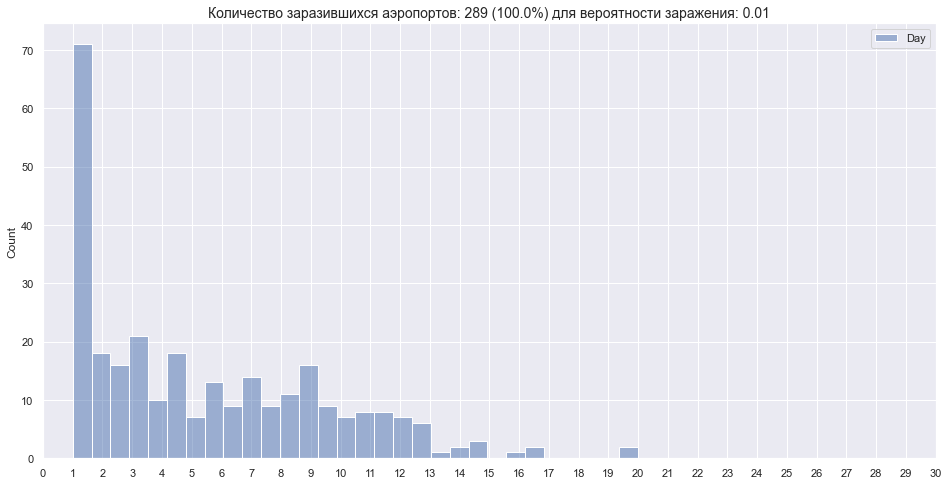

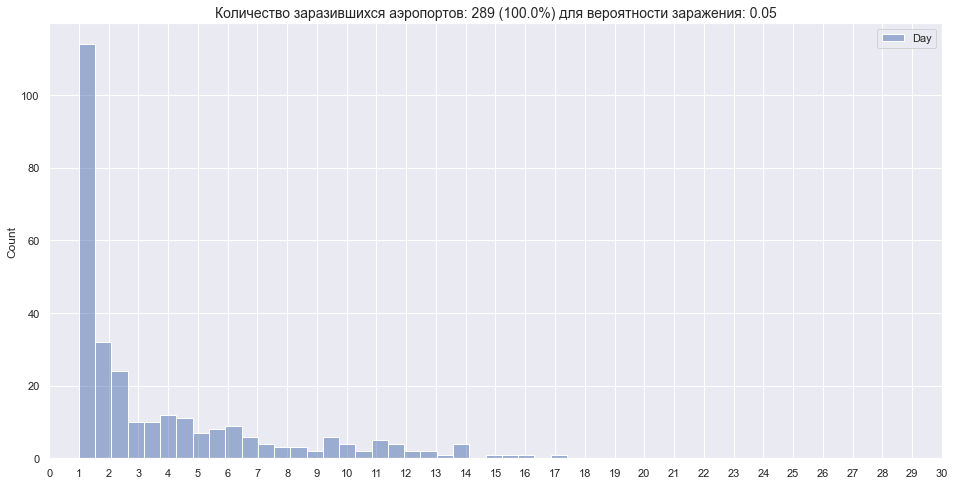

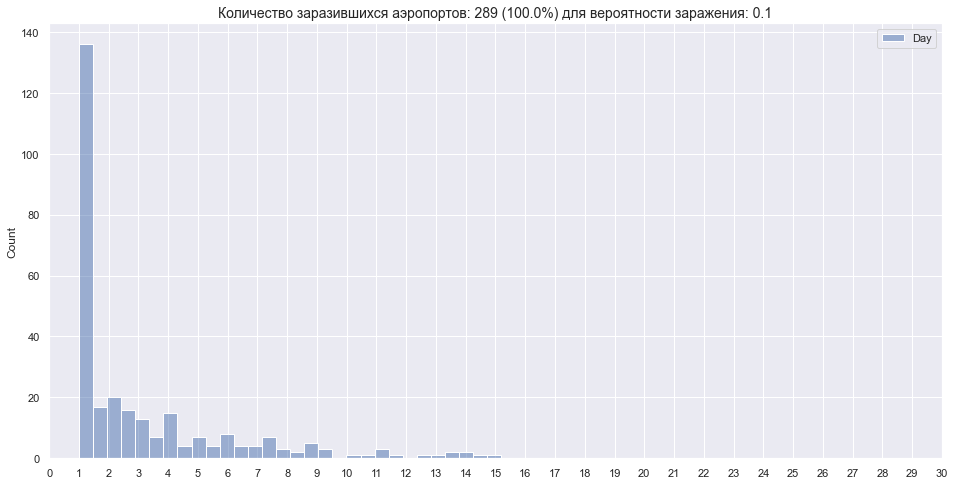

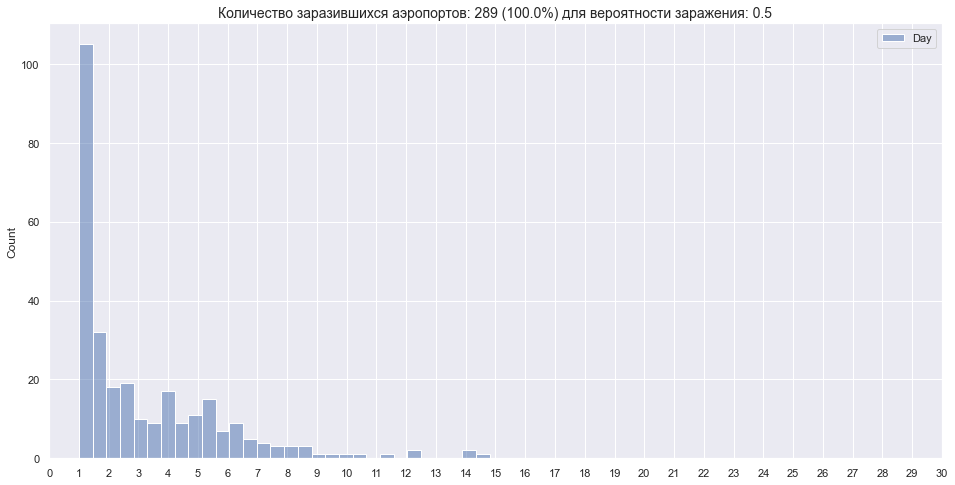

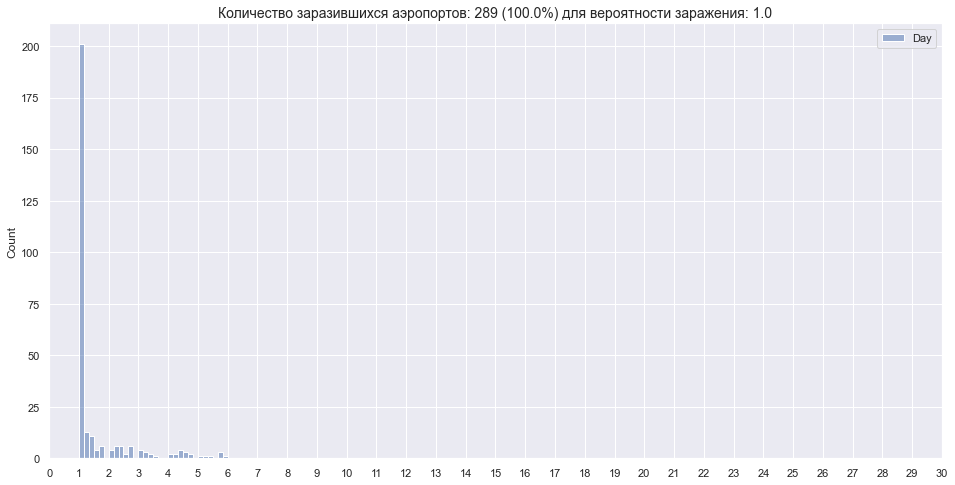

In [20]:
for index, inf_prob in enumerate(inf_prob_list):
    city_dct_df = pd.DataFrame(city_infected_list[index].items(), columns=['Airport', 'Day'])
    sns.set(rc={'figure.figsize':(16,8)})
    ax = sns.histplot(city_dct_df.loc[city_dct_df['Day'] > 0], bins=30)
    inf_count = infected_airport_count(city_infected_list[index])
    ax.set_title(f'Количество заразившихся аэропортов: {inf_count} ({round(inf_count * 100.0 / airport_count, 2)}%) для вероятности заражения: {inf_prob}', fontsize=14)
    plt.xticks(range(31))
    ax.set_label("")
    plt.show();

In [40]:
halfday_list=np.arange(start=1.0, stop=30.5, step=0.5)

In [38]:
for index_prob, inf_prob in enumerate(inf_prob_list):
    for infect_airport, infect_day in city_infected_list[index_prob].items():
        city_infected_list[index_prob][infect_airport] = round(city_infected_list[index_prob][infect_airport] * 2) / 2

Визуализируем динамику заражения аэропортов в зависимости от вероятности заражения:

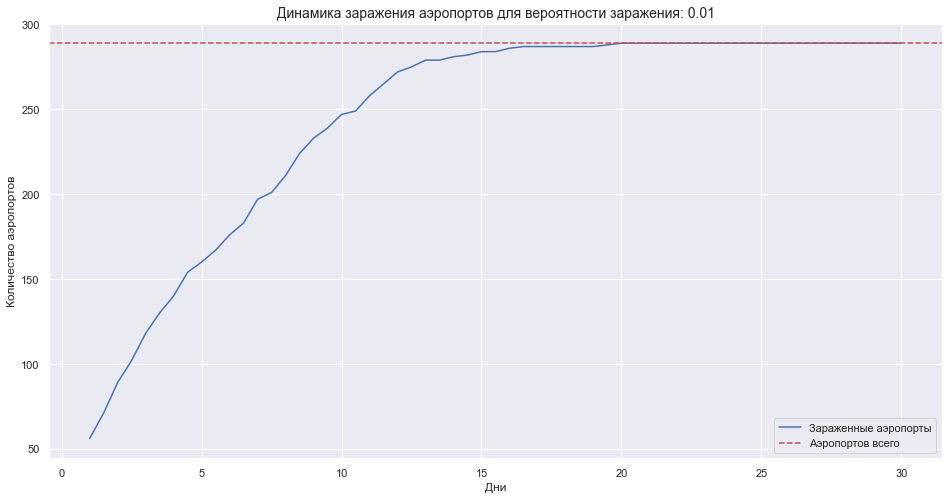

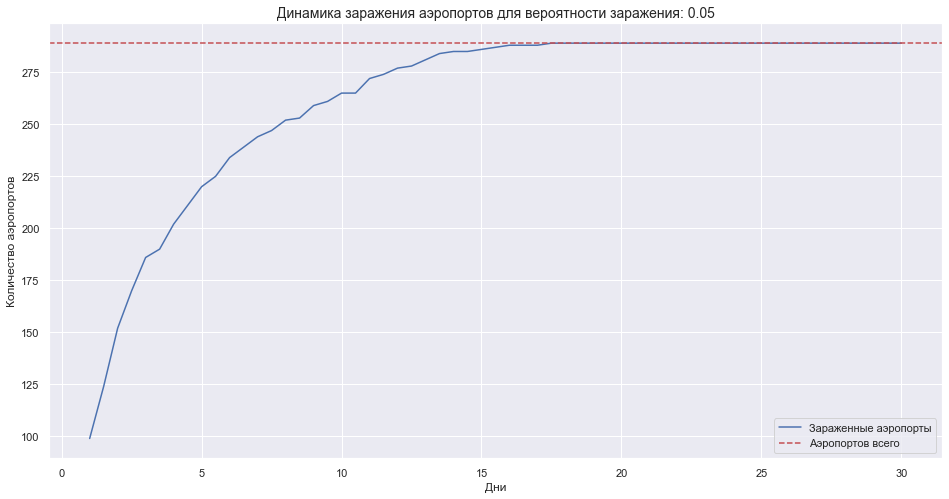

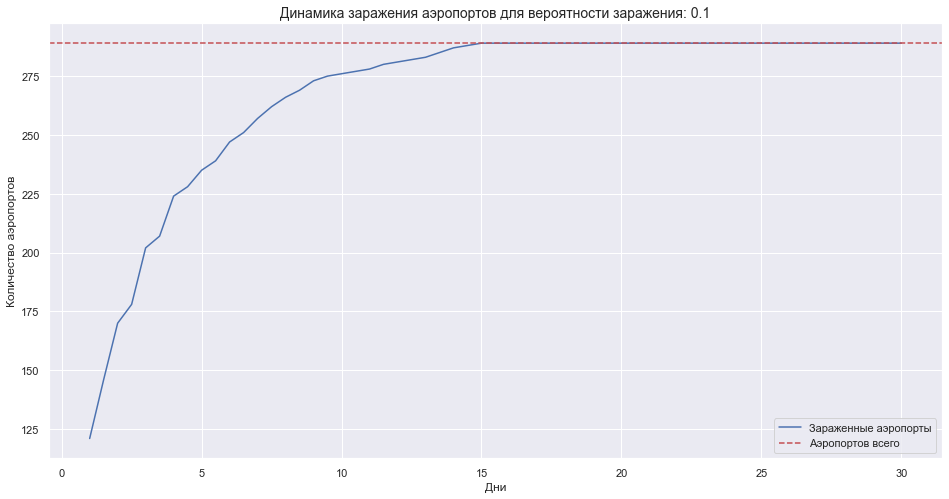

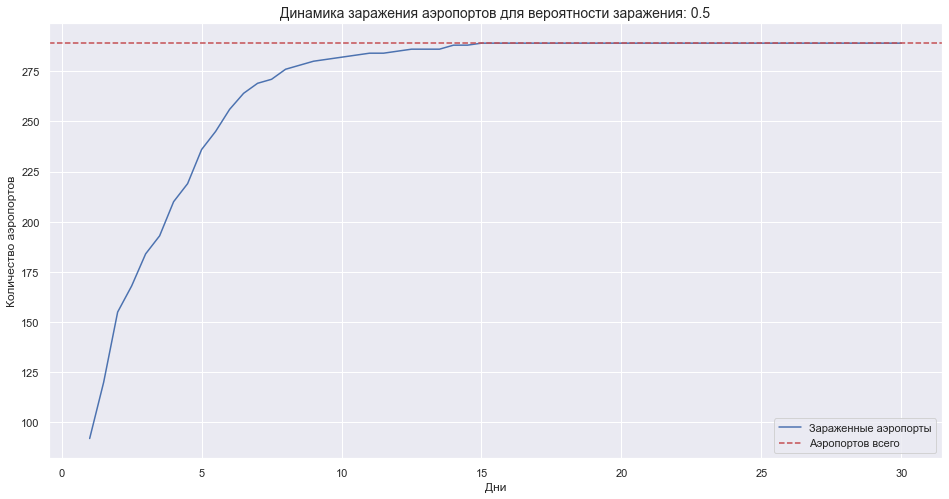

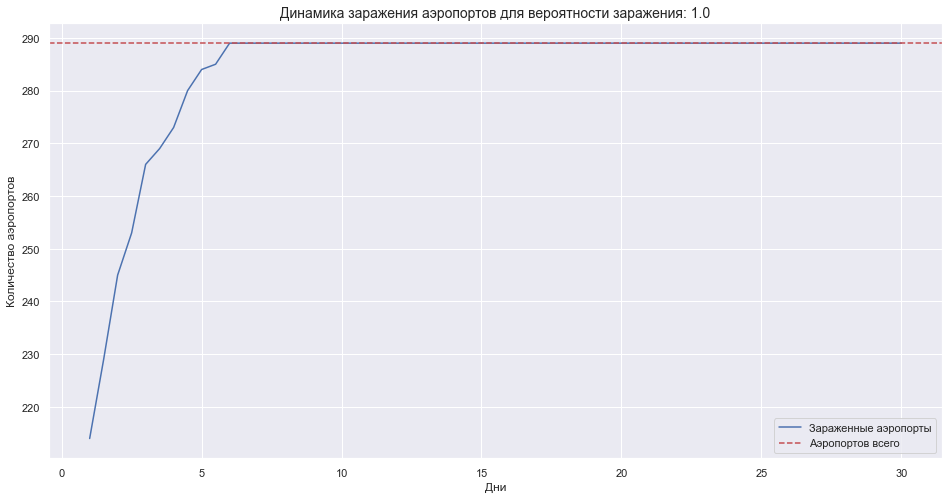

In [44]:
for index_prob, inf_prob in enumerate(inf_prob_list):
    half_day_dict = {}
    for index, half_day in enumerate(halfday_list):
        counter = 0
        for infect_day in city_infected_list[index_prob].values():
            if half_day == infect_day:
                counter += 1
        half_day_dict[half_day] = counter
    for index, value in half_day_dict.items():
        if index > 1.0:
            half_day_dict[index] += half_day_dict[index - 0.5]
    half_count_df = pd.DataFrame(half_day_dict.items(), columns=['Halfday', 'Count'])
    ax = sns.lineplot(x=half_count_df['Halfday'], y=half_count_df['Count'])
    ax.set_title(f'Динамика заражения аэропортов для вероятности заражения: {inf_prob}', fontsize=14)
    plt.axhline(airport_count, linestyle='dashed', color='r')
    ax.set(xlabel='Дни', ylabel='Количество аэропортов')
    labels = ['Зараженные аэропорты', 'Аэропортов всего']
    plt.legend(labels = labels)
    plt.show();

С увеличением вероятности заражения предсказуемо увеличивается скорость заражения 100% аэропортов - с 20 дней для вероятности 1%, до 6 дней для вероятности 100%

In [12]:
G = nx.from_pandas_edgelist(df, source = 'Origin', target = 'Dest')

Рассчитываем веса ребер:

Получаем словарь, в котором подсчитываем количество рейсов в конкретном направлении:

In [153]:
unique, counts = np.unique(list(G.edges()), return_counts=True)
airport_dict = dict(zip(unique, counts))

In [23]:
airways_count_dict = dict(Counter(chain(list(df[['Origin', 'Dest']].itertuples(index=False, name=None)))))

Подсчитываем сумму перелетов в направлении перелета и в обратном: 

In [43]:
for route, fly_count in airways_count_dict.items():
    if airways_count_dict.get((route[1], route[0])):
        ways_count = airways_count_dict[route] + airways_count_dict[(route[1], route[0])]
        airways_count_dict[route] = ways_count
        airways_count_dict[(route[1], route[0])] = ways_count
print(airways_count_dict)

{('STL', 'MCI'): 546, ('STL', 'MCO'): 738, ('STL', 'MDW'): 1232, ('STL', 'OKC'): 224, ('STL', 'OMA'): 342, ('STL', 'PHL'): 240, ('STL', 'PHX'): 878, ('STL', 'SDF'): 328, ('STL', 'SLC'): 464, ('STL', 'TPA'): 360, ('STL', 'TUL'): 336, ('TPA', 'ABQ'): 120, ('TPA', 'ALB'): 120, ('TPA', 'AUS'): 120, ('TPA', 'BDL'): 352, ('TPA', 'BHM'): 334, ('TPA', 'BNA'): 476, ('TPA', 'BUF'): 240, ('TPA', 'BWI'): 1030, ('TPA', 'CMH'): 244, ('TPA', 'DEN'): 364, ('TPA', 'FLL'): 996, ('TPA', 'HOU'): 452, ('TPA', 'IAD'): 516, ('TPA', 'IND'): 360, ('TPA', 'ISP'): 344, ('TPA', 'JAX'): 324, ('TPA', 'LAS'): 360, ('TPA', 'MCI'): 208, ('TPA', 'MDW'): 688, ('TPA', 'MHT'): 240, ('TPA', 'MSY'): 344, ('TPA', 'ORF'): 120, ('TPA', 'PBI'): 446, ('TPA', 'PHL'): 884, ('TPA', 'PHX'): 240, ('TPA', 'PIT'): 326, ('TPA', 'PVD'): 240, ('TPA', 'RDU'): 344, ('TPA', 'SAT'): 120, ('TPA', 'SDF'): 120, ('TPA', 'STL'): 360, ('TUL', 'DAL'): 758, ('TUL', 'HOU'): 428, ('TUL', 'LAS'): 120, ('TUL', 'MCI'): 224, ('TUL', 'PHX'): 336, ('TUL', 'S

Добавляем каждому ребру его вес, согласно условия ДЗ:

In [60]:
for *edge, weight in G.edges(data=True):
    G.edges[tuple(edge)]['weight'] = round(float(airways_count_dict.get(tuple(edge))) / all_airways_count, 5) if airways_count_dict.get(tuple(edge)) else 0.0

Рисуем граф с цветом ребер, зависящим от веса ребер:

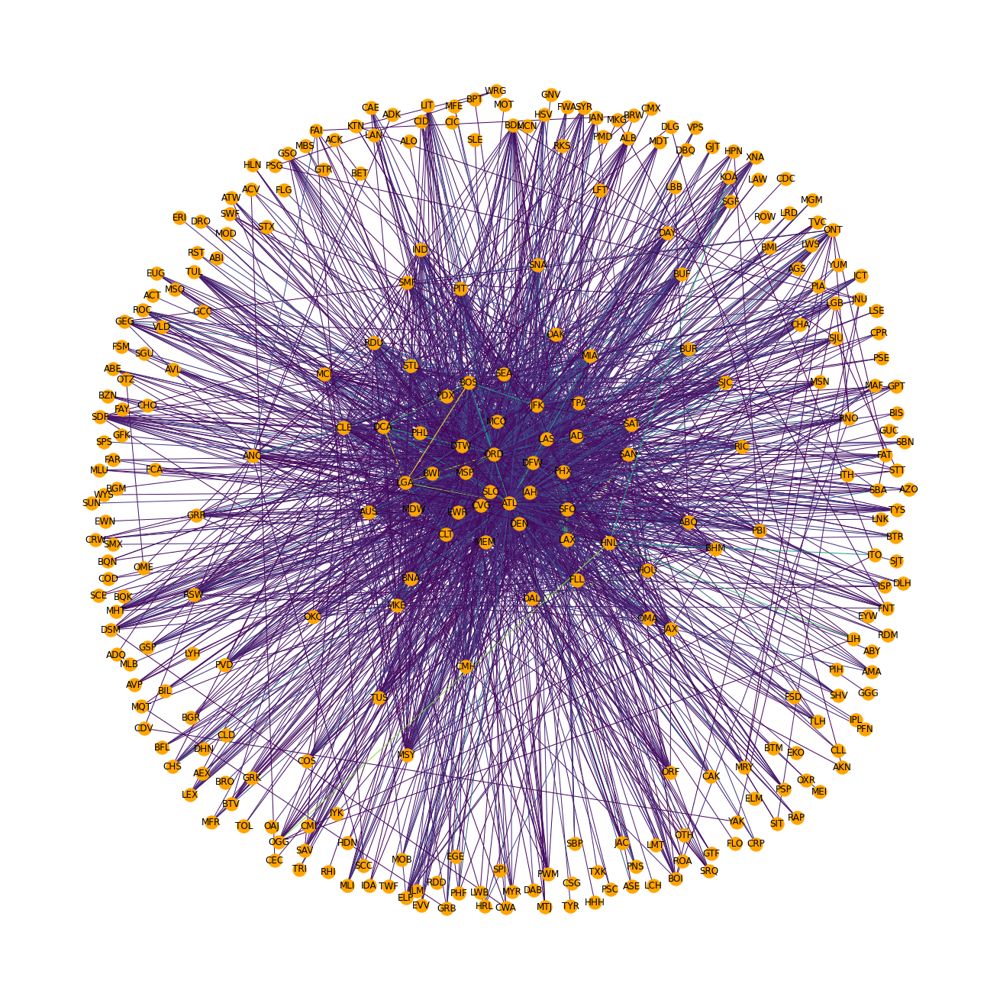

In [66]:
edges,weights = zip(*nx.get_edge_attributes(G,'weight').items())
plt.figure(figsize = (18,18))
pos = nx.spring_layout(G, scale=11, k=2/np.sqrt(G.order()))
d = dict(G.degree)
nx.draw(G, pos, node_color='orange', 
        with_labels=True, 
        edgelist=edges, edge_color=weights,
        nodelist=d)
plt.show()

Рассчитаем медианное время заражения каждого аэропорта, согласно условиям ДЗ (количество итераций сокращено до 25 - очень долгая обработка): 

In [82]:
def median_time_calc(start_city, inf_prob, iter_num):
    result_dict = {item : [] for item in airport_list}
    for i in range(iter_num):
        print(f'\n\tИтерация: {i + 1}')
        city_dct = get_city_dict(start_city, inf_prob)
        for city in city_dct.keys():
            result_dict[city].append(city_dct[city])
    for city in result_dict.keys():
        median_day = np.median(result_dict[city], axis=0)
        result_dict[city] = median_day
    return result_dict

In [83]:
start_city = 'ABE'
city_infected_dict_median = {}
inf_prob = 0.5
print(f'Зараза стартует из аэропорта "{start_city}"')
print(f'\nРасчет медианного времени заражения для вероятности: {inf_prob}')
city_infected_dict_median = median_time_calc(start_city, inf_prob, 25)

Зараза стартует из аэропорта "ABE"

Расчет медианного времени заражения для вероятности: 0.5

	Итерация: 1
		Прогресс обработки датасета: 46.48%		Прогресс обработки датасета: 100.0%
	Итерация: 2
		Прогресс обработки датасета: 8.08%

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



		Прогресс обработки датасета: 13.06%

		Прогресс обработки датасета: 13.67%

		Прогресс обработки датасета: 14.28%

		Прогресс обработки датасета: 14.97%

		Прогресс обработки датасета: 15.59%

		Прогресс обработки датасета: 16.25%

		Прогресс обработки датасета: 16.89%

		Прогресс обработки датасета: 17.51%

		Прогресс обработки датасета: 18.18%

		Прогресс обработки датасета: 18.4%

		Прогресс обработки датасета: 18.52%

		Прогресс обработки датасета: 18.62%

		Прогресс обработки датасета: 18.71%

		Прогресс обработки датасета: 18.81%

		Прогресс обработки датасета: 18.91%

		Прогресс обработки датасета: 18.99%

		Прогресс обработки датасета: 19.08%

		Прогресс обработки датасета: 19.18%

		Прогресс обработки датасета: 19.29%

		Прогресс обработки датасета: 19.38%

		Прогресс обработки датасета: 19.46%

		Прогресс обработки датасета: 19.55%

		Прогресс обработки датасета: 19.66%

		Прогресс обработки датасета: 19.79%

		Прогресс обработки датасета: 19.92%

		Прогресс обработки датасета: 20.07%

		Прогресс обработки датасета: 20.21%

		Прогресс обработки датасета: 20.33%

		Прогресс обработки датасета: 20.46%

		Прогресс обработки датасета: 20.59%

		Прогресс обработки датасета: 20.71%

		Прогресс обработки датасета: 20.83%

		Прогресс обработки датасета: 20.96%

		Прогресс обработки датасета: 21.09%

		Прогресс обработки датасета: 21.23%

		Прогресс обработки датасета: 21.34%

		Прогресс обработки датасета: 21.44%

		Прогресс обработки датасета: 21.51%

		Прогресс обработки датасета: 21.58%

		Прогресс обработки датасета: 21.66%

		Прогресс обработки датасета: 21.76%

		Прогресс обработки датасета: 21.86%

		Прогресс обработки датасета: 21.94%

		Прогресс обработки датасета: 22.03%

		Прогресс обработки датасета: 22.11%

		Прогресс обработки датасета: 22.19%

		Прогресс обработки датасета: 22.28%

		Прогресс обработки датасета: 22.37%

		Прогресс обработки датасета: 22.46%

		Прогресс обработки датасета: 22.54%

		Прогресс обработки датасета: 22.62%

		Прогресс обработки датасета: 22.72%

		Прогресс обработки датасета: 22.82%

		Прогресс обработки датасета: 22.92%

		Прогресс обработки датасета: 23.02%

		Прогресс обработки датасета: 23.12%

		Прогресс обработки датасета: 23.21%

		Прогресс обработки датасета: 23.32%

		Прогресс обработки датасета: 23.42%

		Прогресс обработки датасета: 23.53%

		Прогресс обработки датасета: 23.61%

		Прогресс обработки датасета: 23.7%

		Прогресс обработки датасета: 23.79%

		Прогресс обработки датасета: 23.89%

		Прогресс обработки датасета: 23.98%

		Прогресс обработки датасета: 24.05%

		Прогресс обработки датасета: 24.14%

		Прогресс обработки датасета: 24.24%

		Прогресс обработки датасета: 24.32%

		Прогресс обработки датасета: 24.42%

		Прогресс обработки датасета: 24.5%

		Прогресс обработки датасета: 24.6%

		Прогресс обработки датасета: 24.68%

		Прогресс обработки датасета: 24.79%

		Прогресс обработки датасета: 24.88%

		Прогресс обработки датасета: 24.97%

		Прогресс обработки датасета: 25.03%

		Прогресс обработки датасета: 25.11%

		Прогресс обработки датасета: 25.21%

		Прогресс обработки датасета: 25.29%

		Прогресс обработки датасета: 25.39%

		Прогресс обработки датасета: 25.49%

		Прогресс обработки датасета: 25.57%

		Прогресс обработки датасета: 25.67%

		Прогресс обработки датасета: 25.75%

		Прогресс обработки датасета: 25.83%

		Прогресс обработки датасета: 25.92%

		Прогресс обработки датасета: 26.01%

		Прогресс обработки датасета: 26.09%

		Прогресс обработки датасета: 26.17%

		Прогресс обработки датасета: 26.24%

		Прогресс обработки датасета: 26.32%

		Прогресс обработки датасета: 26.39%

		Прогресс обработки датасета: 26.48%

		Прогресс обработки датасета: 26.54%

		Прогресс обработки датасета: 26.61%

		Прогресс обработки датасета: 26.69%

		Прогресс обработки датасета: 26.77%

		Прогресс обработки датасета: 26.87%

		Прогресс обработки датасета: 26.96%

		Прогресс обработки датасета: 27.04%

		Прогресс обработки датасета: 27.11%

		Прогресс обработки датасета: 27.19%

		Прогресс обработки датасета: 27.27%

		Прогресс обработки датасета: 27.36%

		Прогресс обработки датасета: 27.45%

		Прогресс обработки датасета: 27.55%

		Прогресс обработки датасета: 27.62%

		Прогресс обработки датасета: 27.74%

		Прогресс обработки датасета: 27.8%

		Прогресс обработки датасета: 27.89%

		Прогресс обработки датасета: 27.95%

		Прогресс обработки датасета: 28.02%

		Прогресс обработки датасета: 28.08%

		Прогресс обработки датасета: 28.14%

		Прогресс обработки датасета: 28.19%

		Прогресс обработки датасета: 28.26%

		Прогресс обработки датасета: 28.33%

		Прогресс обработки датасета: 28.39%

		Прогресс обработки датасета: 28.46%

		Прогресс обработки датасета: 28.51%

		Прогресс обработки датасета: 28.56%

		Прогресс обработки датасета: 28.63%

		Прогресс обработки датасета: 28.69%

		Прогресс обработки датасета: 28.75%

		Прогресс обработки датасета: 28.8%

		Прогресс обработки датасета: 28.87%

		Прогресс обработки датасета: 28.93%

		Прогресс обработки датасета: 29.02%

		Прогресс обработки датасета: 29.08%

		Прогресс обработки датасета: 29.16%

		Прогресс обработки датасета: 29.22%

		Прогресс обработки датасета: 29.29%

		Прогресс обработки датасета: 29.37%

		Прогресс обработки датасета: 29.44%

		Прогресс обработки датасета: 29.49%

		Прогресс обработки датасета: 29.56%

		Прогресс обработки датасета: 29.62%

		Прогресс обработки датасета: 29.71%

		Прогресс обработки датасета: 29.78%

		Прогресс обработки датасета: 29.85%

		Прогресс обработки датасета: 29.93%

		Прогресс обработки датасета: 30.0%

		Прогресс обработки датасета: 30.06%

		Прогресс обработки датасета: 30.12%

		Прогресс обработки датасета: 30.18%

		Прогресс обработки датасета: 30.24%

		Прогресс обработки датасета: 30.32%

		Прогресс обработки датасета: 30.38%

		Прогресс обработки датасета: 30.44%

		Прогресс обработки датасета: 30.48%

		Прогресс обработки датасета: 30.54%

		Прогресс обработки датасета: 30.61%

		Прогресс обработки датасета: 30.67%

		Прогресс обработки датасета: 30.74%

		Прогресс обработки датасета: 30.8%

		Прогресс обработки датасета: 30.86%

		Прогресс обработки датасета: 30.92%

		Прогресс обработки датасета: 30.97%

		Прогресс обработки датасета: 31.04%

		Прогресс обработки датасета: 31.14%

		Прогресс обработки датасета: 31.21%

		Прогресс обработки датасета: 31.28%

		Прогресс обработки датасета: 31.34%

		Прогресс обработки датасета: 31.42%

		Прогресс обработки датасета: 31.5%

		Прогресс обработки датасета: 31.56%

		Прогресс обработки датасета: 31.63%

		Прогресс обработки датасета: 31.7%

		Прогресс обработки датасета: 31.77%

		Прогресс обработки датасета: 31.84%

		Прогресс обработки датасета: 31.94%

		Прогресс обработки датасета: 32.01%

		Прогресс обработки датасета: 32.07%

		Прогресс обработки датасета: 32.15%

		Прогресс обработки датасета: 32.21%

		Прогресс обработки датасета: 32.28%

		Прогресс обработки датасета: 32.35%

		Прогресс обработки датасета: 32.42%

		Прогресс обработки датасета: 32.48%

		Прогресс обработки датасета: 32.56%

		Прогресс обработки датасета: 32.63%

		Прогресс обработки датасета: 32.68%

		Прогресс обработки датасета: 32.74%

		Прогресс обработки датасета: 32.81%

		Прогресс обработки датасета: 32.87%

		Прогресс обработки датасета: 32.94%

		Прогресс обработки датасета: 33.0%

		Прогресс обработки датасета: 33.08%

		Прогресс обработки датасета: 33.14%

		Прогресс обработки датасета: 33.2%

		Прогресс обработки датасета: 33.27%

		Прогресс обработки датасета: 33.34%

		Прогресс обработки датасета: 33.41%

		Прогресс обработки датасета: 33.48%

		Прогресс обработки датасета: 33.53%

		Прогресс обработки датасета: 33.6%

		Прогресс обработки датасета: 33.66%

		Прогресс обработки датасета: 33.74%

		Прогресс обработки датасета: 33.81%

		Прогресс обработки датасета: 33.89%

		Прогресс обработки датасета: 33.96%

		Прогресс обработки датасета: 34.03%

		Прогресс обработки датасета: 34.09%

		Прогресс обработки датасета: 34.15%

		Прогресс обработки датасета: 34.22%

		Прогресс обработки датасета: 34.3%

		Прогресс обработки датасета: 34.37%

		Прогресс обработки датасета: 34.44%

		Прогресс обработки датасета: 34.52%

		Прогресс обработки датасета: 34.59%

		Прогресс обработки датасета: 34.66%

		Прогресс обработки датасета: 34.74%

		Прогресс обработки датасета: 34.79%

		Прогресс обработки датасета: 34.86%

		Прогресс обработки датасета: 34.94%

		Прогресс обработки датасета: 35.01%

		Прогресс обработки датасета: 35.1%

		Прогресс обработки датасета: 35.16%

		Прогресс обработки датасета: 35.23%

		Прогресс обработки датасета: 35.31%

		Прогресс обработки датасета: 35.38%

		Прогресс обработки датасета: 35.45%

		Прогресс обработки датасета: 35.52%

		Прогресс обработки датасета: 35.58%

		Прогресс обработки датасета: 35.63%

		Прогресс обработки датасета: 35.71%

		Прогресс обработки датасета: 35.77%

		Прогресс обработки датасета: 35.83%

		Прогресс обработки датасета: 35.9%

		Прогресс обработки датасета: 35.97%

		Прогресс обработки датасета: 36.03%

		Прогресс обработки датасета: 36.11%

		Прогресс обработки датасета: 36.17%

		Прогресс обработки датасета: 36.24%

		Прогресс обработки датасета: 36.29%

		Прогресс обработки датасета: 36.35%

		Прогресс обработки датасета: 36.42%

		Прогресс обработки датасета: 36.49%

		Прогресс обработки датасета: 36.56%

		Прогресс обработки датасета: 36.63%

		Прогресс обработки датасета: 36.7%

		Прогресс обработки датасета: 36.77%

		Прогресс обработки датасета: 36.85%

		Прогресс обработки датасета: 36.91%

		Прогресс обработки датасета: 36.97%

		Прогресс обработки датасета: 37.04%

		Прогресс обработки датасета: 37.13%

		Прогресс обработки датасета: 37.21%

		Прогресс обработки датасета: 37.3%

		Прогресс обработки датасета: 37.36%

		Прогресс обработки датасета: 37.46%

		Прогресс обработки датасета: 37.54%

		Прогресс обработки датасета: 37.6%

		Прогресс обработки датасета: 37.68%

		Прогресс обработки датасета: 37.75%

		Прогресс обработки датасета: 37.82%

		Прогресс обработки датасета: 37.9%

		Прогресс обработки датасета: 37.97%

		Прогресс обработки датасета: 38.04%

		Прогресс обработки датасета: 38.11%

		Прогресс обработки датасета: 38.18%

		Прогресс обработки датасета: 38.24%

		Прогресс обработки датасета: 38.31%

		Прогресс обработки датасета: 38.38%

		Прогресс обработки датасета: 38.47%

		Прогресс обработки датасета: 38.52%

		Прогресс обработки датасета: 38.6%

		Прогресс обработки датасета: 38.69%

		Прогресс обработки датасета: 38.76%

		Прогресс обработки датасета: 38.83%

		Прогресс обработки датасета: 38.91%

		Прогресс обработки датасета: 38.98%

		Прогресс обработки датасета: 39.06%

		Прогресс обработки датасета: 39.14%

		Прогресс обработки датасета: 39.21%

		Прогресс обработки датасета: 39.27%

		Прогресс обработки датасета: 39.34%

		Прогресс обработки датасета: 39.4%

		Прогресс обработки датасета: 39.49%

		Прогресс обработки датасета: 39.55%

		Прогресс обработки датасета: 39.63%

		Прогресс обработки датасета: 39.7%

		Прогресс обработки датасета: 39.76%

		Прогресс обработки датасета: 39.82%

		Прогресс обработки датасета: 39.88%

		Прогресс обработки датасета: 39.95%

		Прогресс обработки датасета: 40.02%

		Прогресс обработки датасета: 40.08%

		Прогресс обработки датасета: 40.15%

		Прогресс обработки датасета: 40.23%

		Прогресс обработки датасета: 40.3%

		Прогресс обработки датасета: 40.36%

		Прогресс обработки датасета: 40.44%

		Прогресс обработки датасета: 40.52%

		Прогресс обработки датасета: 40.6%

		Прогресс обработки датасета: 40.66%

		Прогресс обработки датасета: 40.73%

		Прогресс обработки датасета: 40.81%

		Прогресс обработки датасета: 40.87%

		Прогресс обработки датасета: 40.93%

		Прогресс обработки датасета: 41.0%

		Прогресс обработки датасета: 41.07%

		Прогресс обработки датасета: 41.14%

		Прогресс обработки датасета: 41.21%

		Прогресс обработки датасета: 41.29%

		Прогресс обработки датасета: 41.37%

		Прогресс обработки датасета: 41.44%

		Прогресс обработки датасета: 41.51%

		Прогресс обработки датасета: 41.59%

		Прогресс обработки датасета: 41.65%

		Прогресс обработки датасета: 41.74%

		Прогресс обработки датасета: 41.8%

		Прогресс обработки датасета: 41.86%

		Прогресс обработки датасета: 41.93%

		Прогресс обработки датасета: 42.0%

		Прогресс обработки датасета: 42.06%

		Прогресс обработки датасета: 42.15%

		Прогресс обработки датасета: 42.21%

		Прогресс обработки датасета: 42.28%

		Прогресс обработки датасета: 42.34%

		Прогресс обработки датасета: 42.4%

		Прогресс обработки датасета: 42.47%

		Прогресс обработки датасета: 42.53%

		Прогресс обработки датасета: 42.6%

		Прогресс обработки датасета: 42.69%

		Прогресс обработки датасета: 42.76%

		Прогресс обработки датасета: 42.83%

		Прогресс обработки датасета: 42.91%

		Прогресс обработки датасета: 42.98%

		Прогресс обработки датасета: 43.05%

		Прогресс обработки датасета: 43.11%

		Прогресс обработки датасета: 43.17%

		Прогресс обработки датасета: 43.25%

		Прогресс обработки датасета: 43.31%

		Прогресс обработки датасета: 43.38%

		Прогресс обработки датасета: 43.44%

		Прогресс обработки датасета: 43.5%

		Прогресс обработки датасета: 43.57%

		Прогресс обработки датасета: 43.64%

		Прогресс обработки датасета: 43.71%

		Прогресс обработки датасета: 43.77%

		Прогресс обработки датасета: 43.84%

		Прогресс обработки датасета: 43.92%

		Прогресс обработки датасета: 43.99%

		Прогресс обработки датасета: 44.06%

		Прогресс обработки датасета: 44.12%

		Прогресс обработки датасета: 44.19%

		Прогресс обработки датасета: 44.27%

		Прогресс обработки датасета: 44.35%

		Прогресс обработки датасета: 44.41%

		Прогресс обработки датасета: 44.48%

		Прогресс обработки датасета: 44.56%

		Прогресс обработки датасета: 44.61%

		Прогресс обработки датасета: 44.69%

		Прогресс обработки датасета: 44.76%

		Прогресс обработки датасета: 44.85%

		Прогресс обработки датасета: 44.92%

		Прогресс обработки датасета: 44.98%

		Прогресс обработки датасета: 45.06%

		Прогресс обработки датасета: 45.14%

		Прогресс обработки датасета: 45.22%

		Прогресс обработки датасета: 45.29%

		Прогресс обработки датасета: 45.34%

		Прогресс обработки датасета: 45.43%

		Прогресс обработки датасета: 45.5%

		Прогресс обработки датасета: 45.57%

		Прогресс обработки датасета: 45.65%

		Прогресс обработки датасета: 45.72%

		Прогресс обработки датасета: 45.78%

		Прогресс обработки датасета: 45.85%

		Прогресс обработки датасета: 45.92%

		Прогресс обработки датасета: 46.0%

		Прогресс обработки датасета: 46.08%

		Прогресс обработки датасета: 46.15%

		Прогресс обработки датасета: 46.22%

		Прогресс обработки датасета: 46.3%

		Прогресс обработки датасета: 46.38%

		Прогресс обработки датасета: 46.46%

		Прогресс обработки датасета: 46.54%

		Прогресс обработки датасета: 46.6%

		Прогресс обработки датасета: 46.67%

		Прогресс обработки датасета: 46.74%

		Прогресс обработки датасета: 46.8%

		Прогресс обработки датасета: 46.87%

		Прогресс обработки датасета: 46.95%

		Прогресс обработки датасета: 47.01%

		Прогресс обработки датасета: 47.08%

		Прогресс обработки датасета: 47.16%

		Прогресс обработки датасета: 47.23%

		Прогресс обработки датасета: 47.31%

		Прогресс обработки датасета: 47.37%

		Прогресс обработки датасета: 47.44%

		Прогресс обработки датасета: 47.52%

		Прогресс обработки датасета: 47.59%

		Прогресс обработки датасета: 47.66%

		Прогресс обработки датасета: 47.72%

		Прогресс обработки датасета: 47.8%

		Прогресс обработки датасета: 47.87%

		Прогресс обработки датасета: 47.93%

		Прогресс обработки датасета: 48.01%

		Прогресс обработки датасета: 48.08%

		Прогресс обработки датасета: 48.16%

		Прогресс обработки датасета: 48.23%

		Прогресс обработки датасета: 48.3%

		Прогресс обработки датасета: 48.38%

		Прогресс обработки датасета: 48.45%

		Прогресс обработки датасета: 48.52%

		Прогресс обработки датасета: 48.59%

		Прогресс обработки датасета: 48.64%

		Прогресс обработки датасета: 48.72%

		Прогресс обработки датасета: 48.79%

		Прогресс обработки датасета: 48.86%

		Прогресс обработки датасета: 48.93%

		Прогресс обработки датасета: 49.0%

		Прогресс обработки датасета: 49.06%

		Прогресс обработки датасета: 49.13%

		Прогресс обработки датасета: 49.19%

		Прогресс обработки датасета: 49.28%

		Прогресс обработки датасета: 49.34%

		Прогресс обработки датасета: 49.4%

		Прогресс обработки датасета: 49.47%

		Прогресс обработки датасета: 49.53%

		Прогресс обработки датасета: 49.58%

		Прогресс обработки датасета: 49.65%

		Прогресс обработки датасета: 49.74%

		Прогресс обработки датасета: 49.8%

		Прогресс обработки датасета: 49.87%

		Прогресс обработки датасета: 49.94%

		Прогресс обработки датасета: 50.01%

		Прогресс обработки датасета: 50.08%

		Прогресс обработки датасета: 50.14%

		Прогресс обработки датасета: 50.21%

		Прогресс обработки датасета: 50.28%

		Прогресс обработки датасета: 50.35%

		Прогресс обработки датасета: 50.42%

		Прогресс обработки датасета: 50.5%

		Прогресс обработки датасета: 50.58%

		Прогресс обработки датасета: 50.63%

		Прогресс обработки датасета: 50.71%

		Прогресс обработки датасета: 50.78%

		Прогресс обработки датасета: 50.85%

		Прогресс обработки датасета: 50.92%

		Прогресс обработки датасета: 51.0%

		Прогресс обработки датасета: 51.06%

		Прогресс обработки датасета: 51.13%

		Прогресс обработки датасета: 51.21%

		Прогресс обработки датасета: 51.28%

		Прогресс обработки датасета: 51.35%

		Прогресс обработки датасета: 51.4%

		Прогресс обработки датасета: 51.47%

		Прогресс обработки датасета: 51.53%

		Прогресс обработки датасета: 51.59%

		Прогресс обработки датасета: 51.65%

		Прогресс обработки датасета: 51.73%

		Прогресс обработки датасета: 51.8%

		Прогресс обработки датасета: 51.86%

		Прогресс обработки датасета: 51.93%

		Прогресс обработки датасета: 52.02%

		Прогресс обработки датасета: 52.09%

		Прогресс обработки датасета: 52.15%

		Прогресс обработки датасета: 52.21%

		Прогресс обработки датасета: 52.27%

		Прогресс обработки датасета: 52.35%

		Прогресс обработки датасета: 52.41%

		Прогресс обработки датасета: 52.47%

		Прогресс обработки датасета: 52.54%

		Прогресс обработки датасета: 52.62%

		Прогресс обработки датасета: 52.68%

		Прогресс обработки датасета: 52.75%

		Прогресс обработки датасета: 52.82%

		Прогресс обработки датасета: 52.88%

		Прогресс обработки датасета: 52.96%

		Прогресс обработки датасета: 53.03%

		Прогресс обработки датасета: 53.09%

		Прогресс обработки датасета: 53.15%

		Прогресс обработки датасета: 53.23%

		Прогресс обработки датасета: 53.29%

		Прогресс обработки датасета: 53.35%

		Прогресс обработки датасета: 53.41%

		Прогресс обработки датасета: 53.48%

		Прогресс обработки датасета: 53.55%

		Прогресс обработки датасета: 53.62%

		Прогресс обработки датасета: 53.68%

		Прогресс обработки датасета: 53.75%

		Прогресс обработки датасета: 53.81%

		Прогресс обработки датасета: 53.87%

		Прогресс обработки датасета: 53.98%

		Прогресс обработки датасета: 54.04%

		Прогресс обработки датасета: 54.12%

		Прогресс обработки датасета: 54.18%

		Прогресс обработки датасета: 54.24%

		Прогресс обработки датасета: 54.31%

		Прогресс обработки датасета: 54.36%

		Прогресс обработки датасета: 54.42%

		Прогресс обработки датасета: 54.48%

		Прогресс обработки датасета: 54.55%

		Прогресс обработки датасета: 54.61%

		Прогресс обработки датасета: 54.68%

		Прогресс обработки датасета: 54.74%

		Прогресс обработки датасета: 54.8%

		Прогресс обработки датасета: 54.86%

		Прогресс обработки датасета: 54.92%

		Прогресс обработки датасета: 54.99%

		Прогресс обработки датасета: 55.06%

		Прогресс обработки датасета: 55.13%

		Прогресс обработки датасета: 55.19%

		Прогресс обработки датасета: 55.25%

		Прогресс обработки датасета: 55.33%

		Прогресс обработки датасета: 55.39%

		Прогресс обработки датасета: 55.46%

		Прогресс обработки датасета: 55.52%

		Прогресс обработки датасета: 55.59%

		Прогресс обработки датасета: 55.65%

		Прогресс обработки датасета: 55.71%

		Прогресс обработки датасета: 55.78%

		Прогресс обработки датасета: 55.85%

		Прогресс обработки датасета: 55.92%

		Прогресс обработки датасета: 55.99%

		Прогресс обработки датасета: 56.06%

		Прогресс обработки датасета: 56.12%

		Прогресс обработки датасета: 56.17%

		Прогресс обработки датасета: 56.24%

		Прогресс обработки датасета: 56.31%

		Прогресс обработки датасета: 56.39%

		Прогресс обработки датасета: 56.46%

		Прогресс обработки датасета: 56.52%

		Прогресс обработки датасета: 56.57%

		Прогресс обработки датасета: 56.64%

		Прогресс обработки датасета: 56.7%

		Прогресс обработки датасета: 56.77%

		Прогресс обработки датасета: 56.84%

		Прогресс обработки датасета: 56.92%

		Прогресс обработки датасета: 56.97%

		Прогресс обработки датасета: 57.02%

		Прогресс обработки датасета: 57.08%

		Прогресс обработки датасета: 57.15%

		Прогресс обработки датасета: 57.22%

		Прогресс обработки датасета: 57.28%

		Прогресс обработки датасета: 57.33%

		Прогресс обработки датасета: 57.38%

		Прогресс обработки датасета: 57.44%

		Прогресс обработки датасета: 57.5%

		Прогресс обработки датасета: 57.56%

		Прогресс обработки датасета: 57.64%

		Прогресс обработки датасета: 57.69%

		Прогресс обработки датасета: 57.75%

		Прогресс обработки датасета: 57.81%

		Прогресс обработки датасета: 57.88%

		Прогресс обработки датасета: 57.92%

		Прогресс обработки датасета: 57.98%

		Прогресс обработки датасета: 58.05%

		Прогресс обработки датасета: 58.11%

		Прогресс обработки датасета: 58.16%

		Прогресс обработки датасета: 58.23%

		Прогресс обработки датасета: 58.3%

		Прогресс обработки датасета: 58.37%

		Прогресс обработки датасета: 58.43%

		Прогресс обработки датасета: 58.49%

		Прогресс обработки датасета: 58.55%

		Прогресс обработки датасета: 58.61%

		Прогресс обработки датасета: 58.67%

		Прогресс обработки датасета: 58.73%

		Прогресс обработки датасета: 100.0%

In [84]:
clustering_dict = nx.clustering(G)

In [85]:
degree_dict = nx.degree(G)

In [86]:
centrality_dict = nx.betweenness_centrality(G)

In [97]:
for index, value in city_infected_dict_median.items():
    if np.isnan(value):
        city_infected_dict_median[index] = 0.0

In [102]:
city_dct_median_df = pd.DataFrame(city_infected_dict_median.items(), columns=['Airport', 'MedianDay'])
city_dct_clustering_df = pd.DataFrame(dict(clustering_dict).items(), columns=['Airport', 'Clustering'])
city_dct_degree_df = pd.DataFrame(dict(degree_dict).items(), columns=['Airport', 'Degree'])
city_dct_centrality_df = pd.DataFrame(dict(centrality_dict).items(), columns=['Airport', 'Centrality'])

In [111]:
city_dct_median_df['Clustering'] = 0
city_dct_median_df['Degree'] = 0
city_dct_median_df['Centrality'] = 0

In [115]:
for index, row in city_dct_median_df.iterrows():
    city_dct_median_df.loc[index, ('Clustering')] = dict(clustering_dict).get(row['Airport'], 0)
    city_dct_median_df.loc[index, ('Degree')] = dict(degree_dict).get(row['Airport'], 0)
    city_dct_median_df.loc[index, ('Centrality')] = dict(centrality_dict).get(row['Airport'], 0)

In [116]:
city_dct_median_df

,Airport,MedianDay,Clustering,Degree,Centrality
0,STL,5.0,0.657801,48,1.639581e-03
1,TPA,6.0,0.525689,57,4.448246e-03
2,TUL,3.0,0.859649,19,2.640586e-04
3,TUS,11.0,0.853755,23,1.720896e-04
4,ABQ,13.5,0.655462,35,2.451271e-03
...,...,...,...,...,...
284,PSG,5.0,0.000000,2,1.104981e-04
285,WRG,19.0,0.000000,2,1.209834e-05
286,ADK,0.0,0.000000,1,0.000000e+00
287,BQN,17.0,0.666667,3,4.480865e-07


Строим матрицу корреляции методом Спирмана

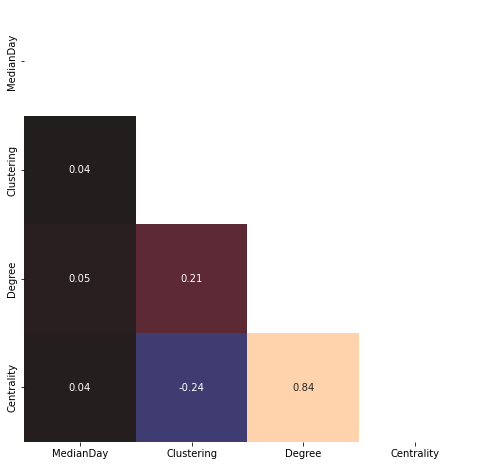

In [120]:
plt.figure(figsize=(8,8))

corr_matrix = city_dct_median_df.corr(method='spearman')
lower = corr_matrix.where(np.tril(np.ones(corr_matrix.shape), k=-1).astype(bool))
sns.heatmap(lower, annot=True, fmt='.2f', cbar=False, center=0);